In [1]:
%matplotlib inline
import sys
import numpy as np
import pandas as pd
import geopandas as gpd

from datetime import datetime
from sklearn.utils import shuffle
import cv2

from datacube import Datacube
import matplotlib.pyplot as plt

sys.path.append("../scripts")
from dea_plotting import map_shapefile
from dea_spatialtools import xr_rasterize

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os
import random

from skimage.io import imread, imshow
from skimage.transform import resize

from numpy import expand_dims
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from skimage import data, img_as_float
from skimage import exposure

dc = Datacube(app="Getting started")

IMG_WIDTH = 224
IMG_HEIGHT = IMG_WIDTH

linescan_datasets = dc.find_datasets(product='linescan')
linescan_datasets = sorted(linescan_datasets, key = lambda ds: (ds.center_time, ds.id))

def clean_name(name):
    if name is None:
        res = None
    else:
        if name.upper()[-4::] == ".JPG":
            res = name.upper()[:-4].replace(' ','_')
        else:
            res = name.upper().replace(' ','_')
    return res

vector_file = 'resources/fire_boundaries.shp'
gdf = gpd.read_file(vector_file)

gdf['SourceNameClean'] = gdf.apply(lambda row: clean_name(row.SourceName), axis=1)
gdf.dtUTC = gdf.apply(lambda row: datetime.strptime(row.dtUTC, '%Y-%m-%d %H:%M:%S'), axis=1)
gdf.dtLocal = gdf.apply(lambda row: datetime.strptime(row.dtLocal, '%Y-%m-%d %H:%M:%S'), axis=1)

seed = 1322
nb_more_images = 7

/env/lib/python3.6/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.7.2-CAPI-1.11.0 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string
/env/lib/python3.6/site-packages/keras_preprocessing/image/image_data_generator.py:337: UserWarning: This ImageDataGenerator specifies `zca_whitening`, which overrides setting of `featurewise_center`.
  warnings.warn('This ImageDataGenerator specifies '


In [2]:
linescans_tres_chelous = [
    'WALHALLA_378_P1_201902041304_MGA94_55',
    'MACALISTER91_615_P1_201903051438_MGA94_55',
    'MACALISTER87_719_P1_201903100033_MGA94_55',
    'MACALISTER97_765_P1_201903131230_MGA94_55',
    'MACALISTER97_774_P1_201903141339_MGA94_55',
    'MACALISTER97_788_P1_201903151324_MGA94_55'
]

linescans_chelous = [
    'MACALISTER_696_P1_201903091545_MGA94_55',
    'MACALISTER_697_P1_201903091555_MGA94_55',
    'MACALISTER_700_P1_201903091613_MGA94_55',
    'YARRA51_809_P1_201903161558_MGA94_55'
]

composites_tres_chelou = [
    'MACALISTER85_684_P1_201903080536_MGA94_55',
    'MACALISTER91_685_P1_201903080539_MGA94_55',
    'MACALISTER91_752_P1_201903111601_MGA94_55',
    'MACALISTER91_760_P1_201903111709_MGA94_55',
    'MACALISTER91_761_P1_201903111720_MGA94_55',
    'MACALISTER91_762_P1_201903111730_MGA94_55',
    'MACALISTER91_783_P1_201903141643_MGA94_55',
    'MACALISTER91_804_P1_201903161503_MGA94_55',
    'MACALISTER91_805_P1_201903161517_MGA94_55',
    'MACALISTER99_646_P1_201903070440_MGA94_55',
    'MACALISTER91_99_649_P1_201903070453_MGA94_55',
    'MACALISTER_696_P1_201903091545_MGA94_55',
    'MACALISTER_700_P1_201903091613_MGA94_55'
]

composites_chelou = [
    'MACALISTER91_682_P1_201903080526_MGA94_55',
    'MACALISTER91_755_P1_201903111619_MGA94_55',
    'MACALISTER91_767_P1_201903131252_MGA94_55',
    'MACALISTER91_808_P1_201903161539_MGA94_55',
    'MACALISTER_699_P1_201903091610_MGA94_55',
    'MACALISTER_697_P1_201903091555_MGA94_55'
]

In [4]:
original_linescans_size = 0
c = 0
for i in range(len(linescan_datasets)):
    sample = linescan_datasets[i]
    fname = sample.metadata_doc['label']
    print(f"{c} : There are {sum(gdf.SourceNameClean == fname)} polygons for linescan {fname}")
    if sum(gdf.SourceNameClean == fname) != 0:
        original_linescans_size += 1
    c+=1
print(original_linescans_size)        

0 : There are 0 polygons for linescan ROSEDALE_P1_201901041439_MGA94_55
1 : There are 0 polygons for linescan ROSEDALE_1_P1_201901041446_MGA94_55
2 : There are 0 polygons for linescan ROSEDALE_3_P1_201901041501_MGA94_55
3 : There are 0 polygons for linescan POINT_H_62_P1_201901162128_MGA94_55
4 : There are 0 polygons for linescan NUNNETT_73_P1_201901171134_MGA94_55
5 : There are 0 polygons for linescan NUNNETT_88_P1_201901171656_MGA94_55
6 : There are 0 polygons for linescan NUNNETT_96_P1_201901172230_MGA94_55
7 : There are 0 polygons for linescan NUNNETT_107_P1_201901181517_MGA94_55
8 : There are 0 polygons for linescan NUNNETT_121_P1_201901191642_MGA94_55
9 : There are 0 polygons for linescan NUNNETT_128_P1_201901192201_MGA94_55
10 : There are 0 polygons for linescan NUNNETT_173_P1_201901251120_MGA94_55
11 : There are 0 polygons for linescan NUNNETT_174_P1_201901251128_MGA94_55
12 : There are 0 polygons for linescan NUNNETT_175_P1_201901251137_MGA94_55
13 : There are 0 polygons for l

In [5]:
composites = gdf[gdf.SourceName.str.upper().str.contains(",|&|(COMPOSITE)", na=False)]
composites['SourceNameClean'].unique().tolist()

/env/lib/python3.6/site-packages/pandas/core/strings.py:2001: UserWarning: This pattern has match groups. To actually get the groups, use str.extract.
  return func(self, *args, **kwargs)


['COMPOSITE_WALLHALLA_397,398_&_401_20190225_(1311_TO_1342HRS)',
 'MACALISTER_681_&_682,_(684_&_685_MINOR)_COMPOSITE_0517-0539HRS',
 'COMPOSITE_MACALISTER97_803,_806_&__807_1455-1532HRS',
 'MACALISTER91_751,_752,_755,_760,_761_&_762_COMPOSITE_1549-1730HRS',
 'MACALISTER91_766,767_&_770_COMPOSITE_1239-1314HRS',
 'MACALISTER91_775,_776,_779_&_783_COMPOSITE_1345-1643HRS',
 'MACALISTER91_789,_790_&_793_COMPOSITE_1330-1358HRS',
 'MACALISTER91_804,_805_&_808_COMPOSITE_1503-1539HRS',
 'MACALISTER91_646,648_&_649_COMPOSITE_-_0440HRS_TO_0453HRS',
 'MACALISTER_695,698_&_699_COMPOSITE_1542_-_1610HRS',
 'MACALISTER_696,697,700_-_1545-1613HRS',
 'COMPOSITE_WALLHALLA_380_&_381_20190206_(1347_&_1356HRS)']

In [6]:
train = pd.read_csv('resources/challenge1_train.csv', index_col='id')
train_labels = train['label'].unique().tolist()
test = pd.read_csv('resources/challenge1_test.csv', index_col='id')
test_labels = test['label'].unique().tolist()
print("Il y a "+str(len(train_labels))+" linescans d'entrainements et " + str(len(test_labels)) + " linescans de tests")

Il y a 129 linescans d'entrainements et 5 linescans de tests


In [7]:
linescan_datasets_train = []
linescan_datasets_test = []
for i in range(len(linescan_datasets)):
    sample = linescan_datasets[i]
    fname = sample.metadata_doc['label']
    if fname in train_labels:
        linescan_datasets_train.append(sample) #129
    else:
        linescan_datasets_test.append(sample) #5

Affichage de tous les linescans train (pas obliger de l'éxécuter)

In [ ]:
for i in range(len(linescan_datasets_train)):
    sample = linescan_datasets_train[i]
    fname = sample.metadata_doc['label']

    if sum(gdf.SourceNameClean == fname) != 0:
        print(fname)
        ob = gdf.loc[gdf.SourceNameClean == fname]
        src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))
        image = src.linescan.values[0]
        mask = xr_rasterize(gdf=ob, da=src).values.astype('float')
        f = plt.figure()
        f.set_figheight(10)
        f.set_figwidth(10)
        f.add_subplot(1, 2, 1)
        plt.imshow(image)
        f.add_subplot(1, 2, 2)
        plt.imshow(np.squeeze(mask))
        plt.show(block=True)

Affichage de tous les composites train (pas obliger de l'éxécuter)

In [ ]:
for composite in composites['SourceNameClean'].unique():
    ob = gdf.loc[gdf.SourceNameClean == composite]
    
    result = composite_polygons(composite)
    linescans = match_composite_linescan(result)
    
    for linescan in linescans:
        if linescan not in test_labels:
            print(linescan)
            src = dc.load(product='linescan', label=linescan, output_crs='epsg:28355', resolution=(-10,10))
            image = src.linescan.values[0]
            mask = xr_rasterize(gdf=ob, da=src).values.astype(float)
            f = plt.figure()
            f.set_figheight(10)
            f.set_figwidth(10)
            f.add_subplot(1, 2, 1)
            plt.imshow(image)
            f.add_subplot(1, 2, 2)
            plt.imshow(np.squeeze(mask))
            plt.show(block=True)



In [8]:
composites = gdf[gdf.SourceName.str.upper().str.contains(",|&|(COMPOSITE)", na=False)]

def composite_polygons(composite_name):
    composite_name = composite_name.replace("(", "")
    composite_name = composite_name.replace(")", "")
    split_underscore = composite_name.split("_")
    split_coma = []
    for s in split_underscore:
        split = s.split(",")
        for ss in split:
            split_coma.append(ss)
    result= []
    for e in split_coma:
        if e.isnumeric():
            new_e = int(e)
            if new_e < 1000:
                result.append(new_e)
    return result

def match_composite_linescan(l):
    result = []
    for i in range(len(linescan_datasets)):
        sample = linescan_datasets[i]
        fname = sample.metadata_doc['label']
        for e in l:
            if ("_"+str(e)+"_") in fname :
                result.append(fname)

    return result

composite_size = 0

for composite in composites['SourceNameClean'].unique():
    ob = gdf.loc[gdf.SourceNameClean == composite]
    
    result = composite_polygons(composite)
    linescans = match_composite_linescan(result)
    
    for linescan in linescans:
        if linescan not in test_labels:
            composite_size += 1 
        

134

In [9]:
def image_pre_processing(image):
    high_filter_value = image > np.max(image) - np.mean(image)
    image[high_filter_value] = 255
    # image = cv2.fastNlMeansDenoising(image, None,3,7,21)
    return image

In [10]:
def normalization(image):
    norm_img = np.zeros((image.shape[0],image.shape[1]))
    final_img = cv2.normalize(image,  norm_img, 0, 255, cv2.NORM_MINMAX)
    return final_img

In [11]:
def extract_linescan_mask(image, mask):
    _, binary = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY)
    kernelClose = cv2.getStructuringElement(cv2.MORPH_RECT,(120,120))
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernelClose)
    for x in range(image.shape[0]): 
        for y in range(image.shape[1]):
            if (binary[x, y] == 0):
                mask[x, y] = 0
    return mask

Exemple extract linescan

In [ ]:
sample = linescan_datasets[121]
fname = sample.metadata_doc['label']
ob = gdf.loc[gdf.SourceNameClean == fname]
        
src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))
image = src.linescan.values[0]
mask = xr_rasterize(gdf=ob, da=src).values.astype('float')

display(image, mask)
def extract_linescan_mask(image, mask):
    _, binary = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY)
    kernelClose = cv2.getStructuringElement(cv2.MORPH_RECT,(100,100))
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernelClose)
    for x in range(image.shape[0]): 
        for y in range(image.shape[1]):
            if (binary[x, y] == 0):
                mask[x, y] = 0
    return mask

In [3]:
# Preprocessing
def processing_image(image):
    image = normalization(image)
    image = cv2.GaussianBlur(image, (5, 5), 0)
   
    image = np.stack((image,)*3, axis=-1).astype('float')
    height = 224
    width = 224
    dim = (width, height)
    image = cv2.resize(image, dim, interpolation=cv2.INTER_LINEAR)
    image = image.astype('uint8')
    
    image = image_pre_processing(image)
    #image = cv2.fastNlMeansDenoising(image, None,3,7,21)
    return image
    
def processing_mask(image, mask):
    mask = extract_linescan_mask(image, mask)
    height = 224
    width = 224
    dim = (width, height)
    mask = cv2.resize(mask, dim, interpolation=cv2.INTER_LINEAR)
    mask = np.expand_dims(mask, axis=-1)
    mask = mask.astype('bool')
    return mask

In [12]:
linescans_size = (nb_more_images + 1) * (original_linescans_size - (len(linescans_chelous)+len(linescans_tres_chelous))) + len(linescans_chelous)
composite_size = (nb_more_images + 1) * (composite_size - (len(composites_chelou) +len(composites_tres_chelou))) + len(composites_chelou)
print(linescans_size)
print(composite_size)
print(linescans_size + composite_size) #Taille du dataset

220

Test du processing sur un linescan avant de lancer sur tous les linescans

In [ ]:
sample = linescan_datasets[124]
fname = sample.metadata_doc['label']

ob = gdf.loc[gdf.SourceNameClean == fname]
src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))

image = src.linescan.values[0]
mask = xr_rasterize(gdf=ob, da=src).values.astype('float')

mask = processing_mask(image, mask)
image = processing_image(image)

image = expand_dims(image, 0)

train_batches = ImageDataGenerator(brightness_range=[0.6,1.2],zca_whitening=True,horizontal_flip=True,vertical_flip=True) \
    .flow(image, batch_size=1, seed=seed)

sample_mask = expand_dims(mask, 0)
it_mask = ImageDataGenerator(horizontal_flip=True,vertical_flip=True) \
    .flow(sample_mask, batch_size=1, seed=seed)

imgs = train_batches.next()
img = imgs[0].astype('uint8')
batch_mask = it_mask.next()
msk = batch_mask[0].astype('bool')

f = plt.figure()
f.set_figheight(16)
f.set_figwidth(16)
f.add_subplot(1, 2, 1)
plt.imshow(img)
f.add_subplot(1, 2, 2)
plt.imshow(np.squeeze(msk))
plt.show(block=True)

print("Just One")

for i in range(7):
    imgs = train_batches.next()
    img = imgs[0].astype('uint8')
    batch_mask = it_mask.next()
    msk = batch_mask[0].astype('bool')

    f = plt.figure()
    f.set_figheight(16)
    f.set_figwidth(16)
    f.add_subplot(1, 2, 1)
    plt.imshow(img)
    f.add_subplot(1, 2, 2)
    plt.imshow(np.squeeze(msk))
    plt.show(block=True)

In [13]:
X_train1 = np.zeros((linescans_size, IMG_HEIGHT, IMG_WIDTH, 3), dtype=np.uint8)
Y_train1 = np.zeros((linescans_size, IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)

n = 0

for i in range(len(linescan_datasets_train)):
    sample = linescan_datasets_train[i]
    fname = sample.metadata_doc['label']
    
    if sum(gdf.SourceNameClean == fname) != 0 and (fname not in linescans_tres_chelous):
        
        ob = gdf.loc[gdf.SourceNameClean == fname]
        src = dc.load(product='linescan', id=sample.id, output_crs='epsg:28355', resolution=(-10,10))
        image = src.linescan.values[0]
        mask = xr_rasterize(gdf=ob, da=src).values.astype('float')
        
        mask = processing_mask(image, mask)
        image = processing_image(image)
        
        sample_image = expand_dims(image, 0)
        it_image = ImageDataGenerator(brightness_range=[0.6,1.2],zca_whitening=True,horizontal_flip=True,vertical_flip=True) \
                    .flow(sample_image, batch_size=1, seed=seed)
        sample_mask = expand_dims(mask, 0)
        it_mask = ImageDataGenerator(horizontal_flip=True,vertical_flip=True) \
                    .flow(sample_mask, batch_size=1, seed=seed)
                        
        batch_image = it_image.next()
        img = batch_image[0].astype('uint8')
        batch_mask = it_mask.next()
        msk = batch_mask[0].astype('bool')
        
        X_train1[n] = img
        Y_train1[n] = msk
        
        n += 1
        
        if (fname not in linescans_chelous):
        
            for i in range(nb_more_images):
    
                batch_image = it_image.next()
                img = batch_image[0].astype('uint8')
                batch_mask = it_mask.next()
                msk = batch_mask[0].astype('bool')
                X_train1[n] = img
                Y_train1[n] = msk
                n += 1

X_train1, Y_train1 = shuffle(X_train1, Y_train1)

Rasterizing to match xarray.DataArray dimensions (777, 1171)


/env/lib/python3.6/site-packages/keras_preprocessing/image/image_data_generator.py:720: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn('This ImageDataGenerator specifies '
/env/lib/python3.6/site-packages/keras_preprocessing/image/image_data_generator.py:739: UserWarning: This ImageDataGenerator specifies `zca_whitening`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn('This ImageDataGenerator specifies '


Rasterizing to match xarray.DataArray dimensions (1297, 3333)
Rasterizing to match xarray.DataArray dimensions (1873, 2125)
Rasterizing to match xarray.DataArray dimensions (2052, 2196)
Rasterizing to match xarray.DataArray dimensions (2022, 2435)
Rasterizing to match xarray.DataArray dimensions (2295, 1799)
Rasterizing to match xarray.DataArray dimensions (1908, 2142)
Rasterizing to match xarray.DataArray dimensions (1963, 2224)
Rasterizing to match xarray.DataArray dimensions (1753, 1934)
Rasterizing to match xarray.DataArray dimensions (3314, 1683)
Rasterizing to match xarray.DataArray dimensions (2440, 2132)
Rasterizing to match xarray.DataArray dimensions (3981, 2973)
Rasterizing to match xarray.DataArray dimensions (3736, 3548)
Rasterizing to match xarray.DataArray dimensions (4124, 3915)
Rasterizing to match xarray.DataArray dimensions (3531, 2005)
Rasterizing to match xarray.DataArray dimensions (2855, 2389)
Rasterizing to match xarray.DataArray dimensions (3075, 2637)
Rasteriz

In [14]:
X_train2 = np.zeros((composite_size, IMG_HEIGHT, IMG_WIDTH, 3), dtype=np.uint8)
Y_train2 = np.zeros((composite_size, IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)

n = 0

for composite in composites['SourceNameClean'].unique():
    ob = gdf.loc[gdf.SourceNameClean == composite]
    
    result = composite_polygons(composite)
    linescans = match_composite_linescan(result)
    
    for linescan in linescans:
        if linescan not in test_labels and (linescan not in composites_tres_chelou):
            print(linescan)
            src = dc.load(product='linescan', label=linescan, output_crs='epsg:28355', resolution=(-10,10))
            image = src.linescan.values[0]
            mask = xr_rasterize(gdf=ob, da=src).values.astype(float)
            
            mask = processing_mask(image, mask)
            image = processing_image(image)
            
            sample_image = expand_dims(image, 0)
            it_image = ImageDataGenerator(brightness_range=[0.6,1.2],zca_whitening=True,horizontal_flip=True,vertical_flip=True) \
                        .flow(sample_image, batch_size=1, seed=seed)
            sample_mask = expand_dims(mask, 0)
            it_mask = ImageDataGenerator(horizontal_flip=True,vertical_flip=True) \
                        .flow(sample_mask, batch_size=1, seed=seed)
                    
            batch_image = it_image.next()
            img = batch_image[0].astype('uint8')
            batch_mask = it_mask.next()
            msk = batch_mask[0].astype('bool')
        
            X_train2[n] = img
            Y_train2[n] = msk
            
            n += 1
            
            if linescan not in composites_chelou:
                for i in range(nb_more_images):
                    batch_image = it_image.next()
                    img = batch_image[0].astype('uint8')
                    batch_mask = it_mask.next()
                    msk = batch_mask[0].astype('bool')
                    X_train2[n] = img
                    Y_train2[n] = msk
                    
                    n += 1

X_train2, Y_train2 = shuffle(X_train2, Y_train2) 

WALHALLA_397_P1_201902251311_MGA94_55
Rasterizing to match xarray.DataArray dimensions (2461, 2380)
WALHALLA_398_P1_201902251323_MGA94_55
Rasterizing to match xarray.DataArray dimensions (2580, 2399)
WALHALLA_401_P1_201902251342_MGA94_55
Rasterizing to match xarray.DataArray dimensions (2396, 2352)
MACALISTER91_681_P1_201903080517_MGA94_55
Rasterizing to match xarray.DataArray dimensions (5321, 3249)
MACALISTER91_682_P1_201903080526_MGA94_55
Rasterizing to match xarray.DataArray dimensions (4779, 3548)
MACALISTER97_803_P1_201903161455_MGA94_55
Rasterizing to match xarray.DataArray dimensions (2706, 2357)
MACALISTER97_806_P1_201903161522_MGA94_55
Rasterizing to match xarray.DataArray dimensions (3305, 2314)
MACALISTER97_807_P1_201903161532_MGA94_55
Rasterizing to match xarray.DataArray dimensions (2703, 2290)
MACALISTER91_755_P1_201903111619_MGA94_55
Rasterizing to match xarray.DataArray dimensions (6009, 3245)
MACALISTER91_766_P1_201903131239_MGA94_55
Rasterizing to match xarray.DataAr

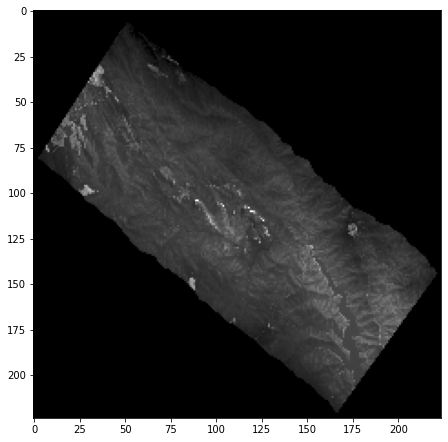

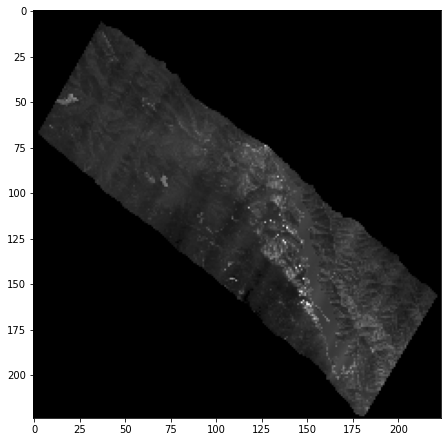

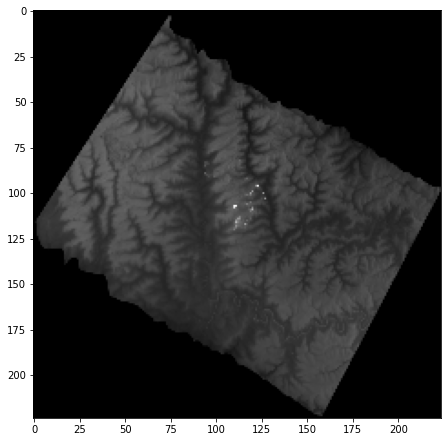

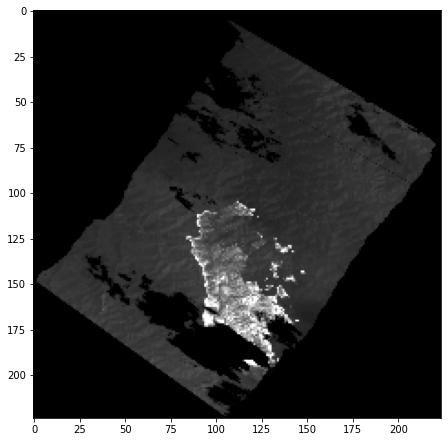

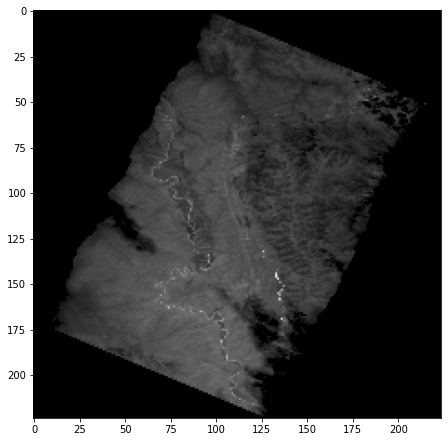

In [15]:
test = pd.read_csv('resources/challenge1_test.csv', index_col='id')
fnames = test.label.unique()
X_test = np.zeros((len(fnames), IMG_HEIGHT, IMG_WIDTH, 3), dtype=np.uint8)

n = 0

for file_stem in fnames:
    src = dc.load(product='linescan', label=file_stem, output_crs='epsg:28355', resolution=(-10,10))
    
    image = src.linescan.values[0]
    image = processing_image(image)

    X_test[n] = image

    f = plt.figure()
    f.set_figheight(7.5)
    f.set_figwidth(7.5)
    plt.imshow(X_test[n])
    plt.show()
    
    n += 1

In [16]:
X_train = np.concatenate((X_train1, X_train2))
Y_train = np.concatenate((Y_train1, Y_train2))
X_train, Y_train = shuffle(X_train, Y_train)

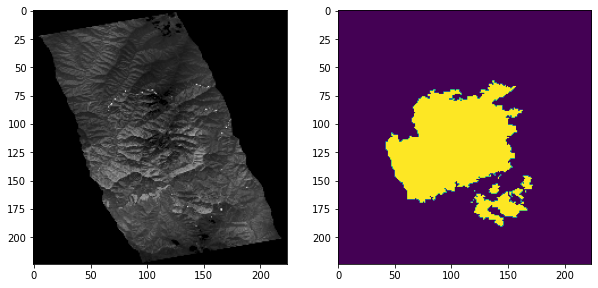

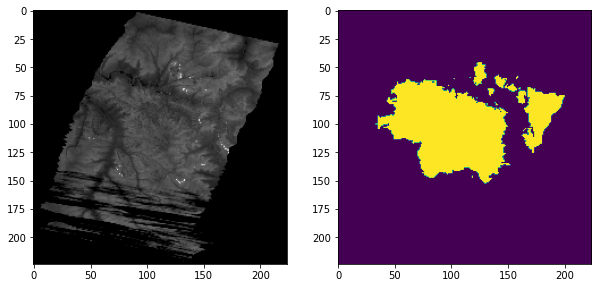

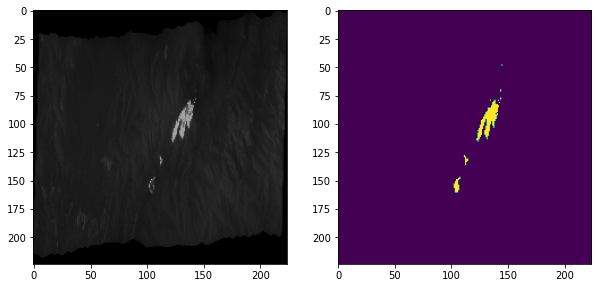

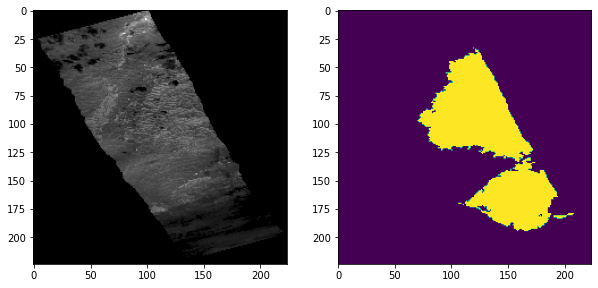

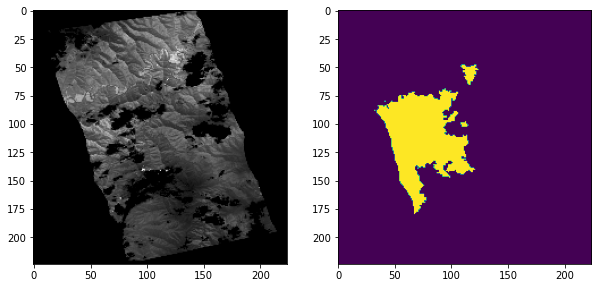

...

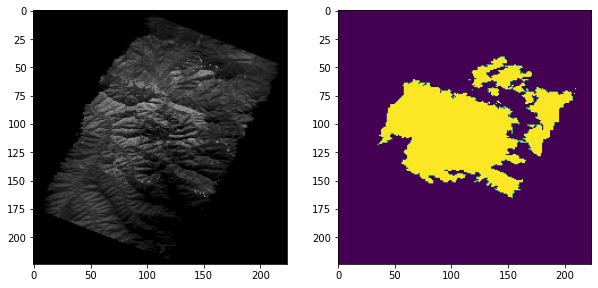

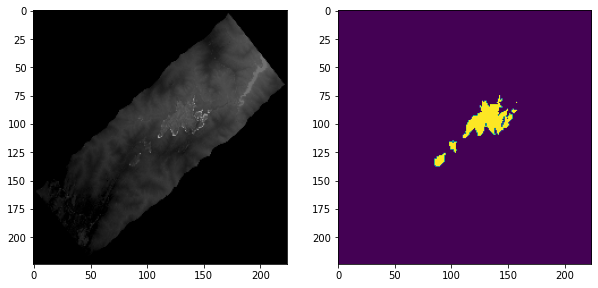

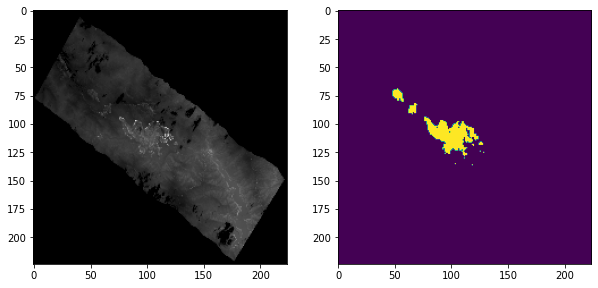

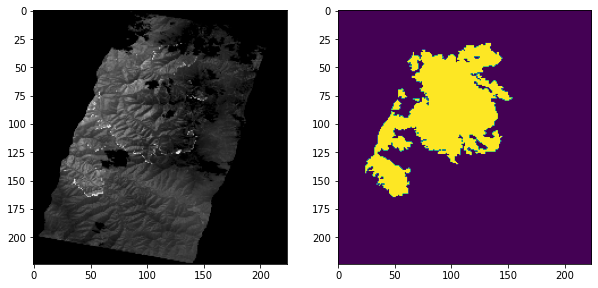

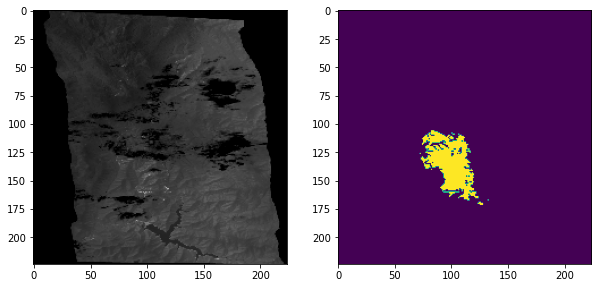

In [17]:
for i in range(X_train.shape[0]):
    f = plt.figure()
    f.set_figheight(10)
    f.set_figwidth(10)
    f.add_subplot(1, 2, 1)
    plt.imshow(X_train[i])
    f.add_subplot(1, 2, 2)
    plt.imshow(np.squeeze(Y_train[i]))
    plt.show(block=True)

In [18]:
np.save('X_test_354_final', X_test)
np.savez_compressed('train_354_final', a=X_train, b=Y_train)